In [1]:
from scipy.io import loadmat
import numpy as np
import tensorflow as tf
import random
import os
import matplotlib.pyplot as plt
from tensorflow.keras.layers import (Input, SeparableConv2D, Conv2D, Conv2DTranspose, Add,
                                     Activation, BatchNormalization, UpSampling2D, Concatenate)
from tensorflow.keras.models import Model
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.regularizers import l2
from tensorflow.keras import backend as K
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.callbacks import EarlyStopping
from skimage.transform import resize
import pandas as pd
from skimage.metrics import structural_similarity as compare_ssim
from skimage.metrics import structural_similarity as ssim

2025-04-24 01:57:21.577662: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-24 01:57:21.599089: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1745449041.622998 3046547 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1745449041.630426 3046547 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-04-24 01:57:21.657532: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instr

Hyperspectral image shape: (610, 340, 103)


/usr/local/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 128205 (\N{ROUND PUSHPIN}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


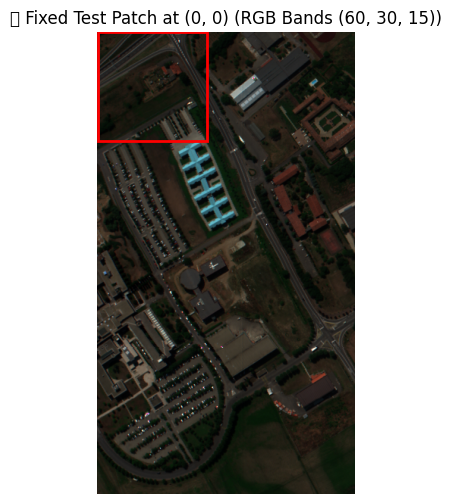

I0000 00:00:1745449046.402217 3046547 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 494 MB memory:  -> device: 0, name: Tesla V100-SXM2-32GB, pci bus id: 0000:89:00.0, compute capability: 7.0



✅ Dataset Preparation Complete (No Data Leakage)
X_train_hr: (19, 144, 144, 32)
X_train_lr: (19, 72, 72, 32)
X_validation_hr: (2, 144, 144, 32)
X_validation_lr: (2, 72, 72, 32)
X_test_hr: (3, 144, 144, 32)
X_test_lr: (3, 72, 72, 32)

📊 Bicubic PSNR: 32.73 dB


In [2]:
##### -----------------------------
# Reproducibility

seed_value = 65
np.random.seed(seed_value)
tf.random.set_seed(seed_value)
random.seed(seed_value)
os.environ['PYTHONHASHSEED'] = str(seed_value)

tf.config.experimental.enable_op_determinism()
tf.config.threading.set_inter_op_parallelism_threads(1)
tf.config.threading.set_intra_op_parallelism_threads(1)

# -----------------------------
# Load PaviaU Dataset
# -----------------------------
data = loadmat("PaviaU.mat")
if 'paviaU' not in data:
    raise KeyError("'paviaU' not found in the .mat file.")
hyperspectral_image = data['paviaU'].astype(np.float32)
print("Hyperspectral image shape:", hyperspectral_image.shape)

# -----------------------------
# Parameters
# -----------------------------
patch_size = (144, 144)
downscale_factor = 2
nodata_value = -1
group_size = 32
overlap_size = 8
validation_ratio = 0.1
test_coords = (0, 0)  # Fixed test patch top-left corner

# -----------------------------
# Optional: Visualize Test Patch Location
# -----------------------------
i0, j0 = test_coords
patch_h, patch_w = patch_size

# Define RGB bands for visualization (you can adjust as needed)
rgb_bands = (60, 30, 15)

# Normalize and stack bands
rgb_image = np.stack([hyperspectral_image[..., i] for i in rgb_bands], axis=-1)
rgb_image = (rgb_image - rgb_image.min()) / (rgb_image.max() - rgb_image.min() + 1e-8)

# Plot with patch overlay
plt.figure(figsize=(6, 6))
plt.imshow(rgb_image)
plt.gca().add_patch(plt.Rectangle((j0, i0), patch_w, patch_h, edgecolor='red', facecolor='none', linewidth=2))
plt.title(f"📍 Fixed Test Patch at {test_coords} (RGB Bands {rgb_bands})")
plt.axis('off')
plt.show()

# -----------------------------
# Extract HR/LR patches spatially
# -----------------------------
def extract_patches(data, patch_size, downscale_factor, nodata_value, test_coords):
    h, w, b = data.shape
    i0, j0 = test_coords

    train_hr, train_lr = [], []
    test_hr, test_lr = None, None

    for i in range(0, h - patch_size[0] + 1, patch_size[0]):
        for j in range(0, w - patch_size[1] + 1, patch_size[1]):
            patch = data[i:i + patch_size[0], j:j + patch_size[1], :]
            if patch.shape[:2] != patch_size or np.any(patch == nodata_value):
                continue
            patch_lr = tf.image.resize(patch,
                                       size=(patch_size[0] // downscale_factor, patch_size[1] // downscale_factor),
                                       method='area').numpy()
            if (i, j) == test_coords:
                test_hr = patch[np.newaxis, ...]
                test_lr = patch_lr[np.newaxis, ...]
            else:
                train_hr.append(patch)
                train_lr.append(patch_lr)

    return (
        np.array(train_hr),
        np.array(train_lr),
        test_hr,
        test_lr
    )

train_hr_full, train_lr_full, test_hr_full, test_lr_full = extract_patches(
    hyperspectral_image, patch_size, downscale_factor, nodata_value, test_coords
)

# -----------------------------
# Band grouping AFTER train/test split
# -----------------------------
def apply_band_grouping(patches, group_size, overlap_size):
    grouped = []
    for patch in patches:
        h, w, bands = patch.shape
        step = group_size - overlap_size
        for g in range(0, bands - group_size + 1, step):
            grouped_patch = patch[:, :, g:g + group_size]
            grouped.append(grouped_patch)
    return np.array(grouped)

X_train_hr = apply_band_grouping(train_hr_full, group_size, overlap_size)
X_train_lr = apply_band_grouping(train_lr_full, group_size, overlap_size)
X_test_hr = apply_band_grouping(test_hr_full, group_size, overlap_size)
X_test_lr = apply_band_grouping(test_lr_full, group_size, overlap_size)

# -----------------------------
# Split 10% of training into validation
# -----------------------------
num_train = X_train_hr.shape[0]
val_size = max(1, int(validation_ratio * num_train))  # ✅ Ensure at least 1 validation sample
indices = np.arange(num_train)
np.random.shuffle(indices)
X_train_hr = X_train_hr[indices]
X_train_lr = X_train_lr[indices]
X_validation_hr = X_train_hr[:val_size]
X_validation_lr = X_train_lr[:val_size]
X_train_hr = X_train_hr[val_size:]
X_train_lr = X_train_lr[val_size:]

# -----------------------------
# Shape Checks
# -----------------------------
print("\n✅ Dataset Preparation Complete (No Data Leakage)")
print("X_train_hr:", X_train_hr.shape)
print("X_train_lr:", X_train_lr.shape)
print("X_validation_hr:", X_validation_hr.shape)
print("X_validation_lr:", X_validation_lr.shape)
print("X_test_hr:", X_test_hr.shape)
print("X_test_lr:", X_test_lr.shape)

# -----------------------------
# PSNR Function
# -----------------------------
def psnr(y_true, y_pred, max_pixel=None):
    if max_pixel is None:
        max_pixel = np.max(y_true)
    psnr_vals = []
    for i in range(y_true.shape[-1]):
        mse = np.mean((y_true[..., i] - y_pred[..., i]) ** 2)
        psnr_band = 20 * np.log10(max_pixel / np.sqrt(mse)) if mse != 0 else float('inf')
        psnr_vals.append(psnr_band)
    return np.mean(psnr_vals)

# -----------------------------
# Bicubic Baseline Evaluation
# -----------------------------
X_test_lr_upsampled = tf.image.resize(
    X_test_lr,
    size=(X_test_hr.shape[1], X_test_hr.shape[2]),
    method='bilinear'
).numpy()

psnr_scores = [psnr(X_test_hr[i], X_test_lr_upsampled[i]) for i in range(X_test_hr.shape[0])]
print(f"\n📊 Bicubic PSNR: {np.mean(psnr_scores):.2f} dB")


In [3]:

# -----------------------------
# Residual Block (Depthwise Separable)
# -----------------------------
def residual_block(x, filters, kernel_size=3):
    shortcut = x
    x = SeparableConv2D(filters, kernel_size, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = SeparableConv2D(filters, kernel_size, padding='same')(x)
    x = BatchNormalization()(x)
    x = Add()([x, shortcut])
    x = Activation('relu')(x)
    return x

# -----------------------------
# Dilated Fusion Block
# -----------------------------
def dilated_fusion_block(x, filters):
    d1 = Conv2D(filters, 3, padding='same', dilation_rate=1, activation='relu')(x)
    d2 = Conv2D(filters, 3, padding='same', dilation_rate=2, activation='relu')(x)
    d3 = Conv2D(filters, 3, padding='same', dilation_rate=3, activation='relu')(x)
    fused = Concatenate()([d1, d2, d3])
    fused = Conv2D(filters, 1, padding='same', activation='relu')(fused)
    return fused

# -----------------------------
# Upsample Block (Modular)
# -----------------------------
def upsample_block(x, filters, scale=2, use_residual=False, use_depthwise=True, use_transpose=False):
    shortcut = x  # for optional residual connection

    if use_transpose:
        x = Conv2DTranspose(filters, kernel_size=4, strides=scale, padding='same', activation='relu')(x)
    else:
        x = UpSampling2D(size=(scale, scale), interpolation='bilinear')(x)
        if use_depthwise:
            x = SeparableConv2D(filters, 3, padding='same', activation='relu')(x)
        else:
            x = Conv2D(filters, 3, padding='same', activation='relu')(x)

    if use_residual:
        if shortcut.shape[-1] != filters or shortcut.shape[1] != x.shape[1] or shortcut.shape[2] != x.shape[2]:
            shortcut = Conv2D(filters, 1, padding='same')(UpSampling2D(size=(scale, scale))(shortcut))
        x = Add()([x, shortcut])

    return x

# -----------------------------
# Spectral Angle Mapper (SAM) Loss
# -----------------------------
def spectral_angle_loss(y_true, y_pred):
    y_true = tf.nn.l2_normalize(y_true, axis=-1)
    y_pred = tf.nn.l2_normalize(y_pred, axis=-1)
    dot_product = tf.reduce_sum(y_true * y_pred, axis=-1)
    angle = tf.acos(tf.clip_by_value(dot_product, -1.0, 1.0))
    return tf.reduce_mean(angle)

# -----------------------------
# L2 Loss (Squared Error Sum)
# -----------------------------
def l2_loss(y_true, y_pred):
    return tf.reduce_mean(tf.square(y_true - y_pred))

# -----------------------------
# Combined Loss: MSE + λ₁ × SAM + λ₂ × L2
# -----------------------------
def combined_loss(lambda_sam=0.1, lambda_l2=0.1):
    mse = MeanSquaredError()
    def loss_fn(y_true, y_pred):
        return mse(y_true, y_pred) + lambda_sam * spectral_angle_loss(y_true, y_pred) + lambda_l2 * l2_loss(y_true, y_pred)
    return loss_fn

# -----------------------------
# Super-Resolution Model with Modular Upsampling
# -----------------------------
def build_simple_sr_model(input_shape,
                          use_transpose=True,
                          use_depthwise=True,
                          use_residual=True):
    inputs = Input(shape=input_shape)

    # Initial feature extraction
    x = SeparableConv2D(64, 3, padding='same', activation='relu')(inputs)

    # Residual blocks
    for _ in range(3):
        x = residual_block(x, 64)

    # Dilated Fusion Block
    x = dilated_fusion_block(x, 64)

    # Upsample x2 → x4 → x8
    x = upsample_block(x, filters=128, scale=2,
                       use_residual=use_residual,
                       use_depthwise=use_depthwise,
                       use_transpose=use_transpose)

    # Final spectral reconstruction
    output = SeparableConv2D(input_shape[-1], 3, padding='same', activation='linear')(x)

    model = Model(inputs, output, name='HSI_SR_Modular_Upsample_Model')
    return model


# -----------------------------
# Model Compilation
# -----------------------------
input_shape = (72, 72, 32)  # Low-resolution input shape (e.g. 1/8 of 144x144)
model = build_simple_sr_model(
    input_shape=input_shape,
    use_transpose=True,         # Toggle between bilinear or transposed
    use_depthwise=True,
    use_residual=True
)

model.compile(
    optimizer='adam',
    loss=combined_loss(lambda_sam=0.5, lambda_l2=0.03),
    metrics=['mse']
)
total_params = model.count_params()
size_in_bytes = total_params * 4  # 4 bytes per float32 param
size_in_mb = size_in_bytes / (1024 ** 2)
print(f"💾 Model size: {size_in_mb:.2f} MB")

#model.summary()

total_params = model.count_params()
params_in_millions = total_params / 1e6
print(f"\n🧠 Total Parameters: {params_in_millions:.2f} Million")
#30,32,  4,99
#Average PSNR on the test set: 30.44809351269405
#Average SSIM on the test set: 0.79255395
#Average SAM on the test set (in degrees): 4,2914740693309

💾 Model size: 1.15 MB

🧠 Total Parameters: 0.30 Million


Epoch 1/1000


2025-04-23 19:35:28.953491: E tensorflow/core/framework/node_def_util.cc:676] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}
I0000 00:00:1745426136.141249 1978652 service.cc:148] XLA service 0x7f66f0015c20 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1745426136.142593 1978652 service.cc:156]   StreamExecutor device (0): Tesla V100-SXM2-32GB, Compute Capability 7

2/5 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 2117669.5000 - mse: 2055989.0000 

I0000 00:00:1745426147.946623 1978652 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - loss: 2049080.6250 - mse: 1989398.2500  

2025-04-23 19:35:54.392572: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:397] ptxas warning : Registers are spilled to local memory in function 'input_reduce_select_fusion_3', 4 bytes spill stores, 4 bytes spill loads

2025-04-23 19:35:54.540640: E tensorflow/core/framework/node_def_util.cc:676] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


5/5 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - loss: 2034779.2500 - mse: 1975513.3750 - val_loss: 1944130.5000 - val_mse: 1887505.0000
Epoch 2/1000
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 1406155.7500 - mse: 1365199.1250 - val_loss: 962717.3125 - val_mse: 934676.6250
Epoch 3/1000
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 771358.5000 - mse: 748891.5000 - val_loss: 521554.1562 - val_mse: 506363.1562
Epoch 4/1000
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 399605.2188 - mse: 387966.0625 - val_loss: 463927.8125 - val_mse: 450415.1875
Epoch 5/1000
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 361470.8750 - mse: 350942.4688 - val_loss: 426000.0625 - val_mse: 413592.2500
Epoch 6/1000
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 327641.2500 - mse: 318098.1875 - val_loss: 385608.7500 - val_mse: 374377.2812
Epoch 7/1000
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 289158.5312 - mse: 280736.3438 - val_loss: 342734.7188 - val_mse: 332752.0625
Epoch 8/1000
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/ste

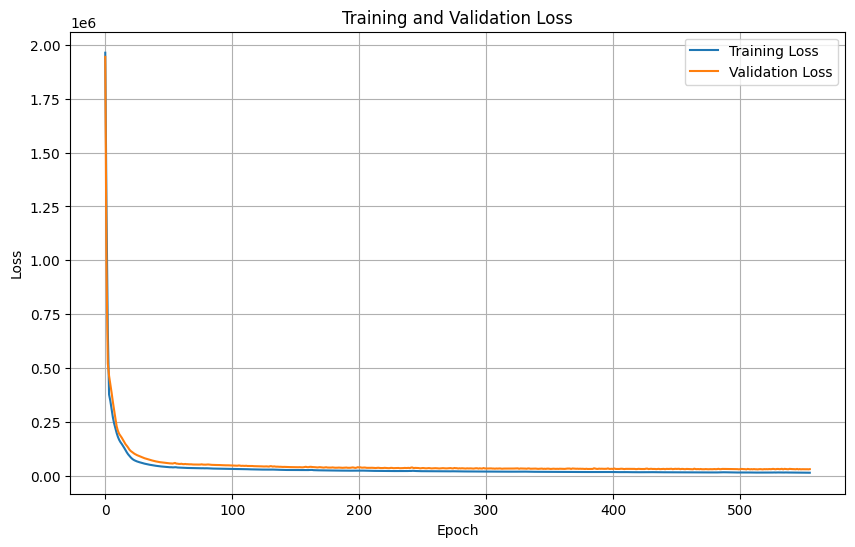

In [4]:
early_stopping = EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

# Train the model and get the training history with early stopping
history = model.fit(
    X_train_lr, 
    X_train_hr, 
    epochs=1000, 
    batch_size=4, 
    validation_data=(X_validation_lr, X_validation_hr),
    callbacks=[early_stopping]  # Add the early stopping callback here
)

# Visualize training and validation loss over epochs
plt.figure(figsize=(10, 6))  # Adjust figure size if needed
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)  # Add grid for better readability
plt.show()

In [5]:
def psnr(y_true, y_pred, max_pixel=None):
    """
    Compute PSNR for each spectral band separately and return the average.
    
    Args:
        y_true: Ground truth image, shape (H, W, B)
        y_pred: Super-resolved image, shape (H, W, B)
        max_pixel: Maximum pixel value (None = use actual max from y_true)
    
    Returns:
        Average PSNR across all bands
    """
    if max_pixel is None:
        max_pixel = np.max(y_true)  # Auto-detect max value if not provided

    B = y_true.shape[-1]  # Number of spectral bands
    psnr_values = []
    
    for i in range(B):  # Loop over bands
        mse = np.mean((y_true[..., i] - y_pred[..., i]) ** 2)
        if mse == 0:
            psnr_values.append(float('inf'))  # Perfect reconstruction
        else:
            psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
            psnr_values.append(psnr)
    
    return np.mean(psnr_values)  # Average across bands

# Function to calculate SSIM with channel_axis
def ssim_value(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        raise ValueError(f"Shape mismatch: y_true shape {y_true.shape} vs y_pred shape {y_pred.shape}")
    
    data_range = y_true.max() - y_true.min()  # Calculate data range from y_true
    ssim_val = ssim(y_true, y_pred, data_range=data_range, channel_axis=-1)
    return ssim_val

# Function to calculate Correlation Coefficient
def correlation_coefficient(y_true, y_pred):
    y_true_flat = y_true.flatten()
    y_pred_flat = y_pred.flatten()
    corr_matrix = np.corrcoef(y_true_flat, y_pred_flat)
    corr_value = corr_matrix[0, 1]
    return corr_value

# Function to calculate Spectral Angle Mapper (SAM) in degrees
def sam(y_true, y_pred):
    y_true_reshaped = y_true.reshape(-1, y_true.shape[-1])
    y_pred_reshaped = y_pred.reshape(-1, y_pred.shape[-1])
    
    non_zero_mask = (np.linalg.norm(y_true_reshaped, axis=1) > 1e-10) & (np.linalg.norm(y_pred_reshaped, axis=1) > 1e-10)
    dot_product = np.sum(y_true_reshaped[non_zero_mask] * y_pred_reshaped[non_zero_mask], axis=1)
    norm_true = np.linalg.norm(y_true_reshaped[non_zero_mask], axis=1)
    norm_pred = np.linalg.norm(y_pred_reshaped[non_zero_mask], axis=1)
    
    with np.errstate(divide='ignore', invalid='ignore'):
        angles = np.arccos(np.clip(dot_product / (norm_true * norm_pred), -1.0, 1.0))
    
    if angles.size > 0:
        sam_value_degrees = np.mean(angles) * (180 / np.pi)
    else:
        sam_value_degrees = 0
    
    return sam_value_degrees

# Function to normalize the images
def normalize(image):
    min_val = np.min(image)
    max_val = np.max(image)
    return (image - min_val) / (max_val - min_val)  # Normalize to [0, 1]

# Function to calculate Root Mean Squared Error (RMSE) for hyperspectral images (normalized)
def rmse_bandwise(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        raise ValueError("Shape mismatch between true and predicted images.")
    
    bands = y_true.shape[-1]
    rmse_per_band = []

    for b in range(bands):
        band_true = y_true[:, :, b]
        band_pred = y_pred[:, :, b]
        
        mse_band = np.mean((band_true - band_pred) ** 2)
        rmse_band_value = np.sqrt(mse_band)
        rmse_per_band.append(rmse_band_value)

    # Normalize RMSE by the maximum value in y_true across all bands
    max_value = np.max(y_true)
    normalized_rmse = np.mean(rmse_per_band) / max_value
    return normalized_rmse

# Function to calculate ERGAS
def ergas(y_true, y_pred, scale):
    bands = y_true.shape[-1]
    ergas_value = 0
    
    for b in range(bands):
        band_true = y_true[:, :, b]
        band_pred = y_pred[:, :, b]
        mean_band_true = np.mean(band_true)
        
        # Calculate RMSE for the band without using a separate function
        mse_band = np.mean((band_true - band_pred) ** 2)  # Mean Squared Error for the band
        rmse_band = np.sqrt(mse_band)  # Root Mean Squared Error for the band
        
        ergas_value += (rmse_band / mean_band_true) ** 2
    
    ergas_value = 100 * (1 / scale) * np.sqrt(ergas_value / bands)
    return ergas_value

# Assuming hybrid_sr_model is trained, and X_test_lr, X_test_hr are defined
predicted_hr_images =  model.predict(X_test_lr)

downscale_factor = 2 # ERGAS downscale factor

# Validate shapes match for test and predictions
if predicted_hr_images.shape != X_test_hr.shape:
    raise ValueError(f"Shape mismatch: predicted_hr_images shape {predicted_hr_images.shape} vs X_test_hr shape {X_test_hr.shape}")

# Calculate metrics per test sample
psnr_values, ssim_values, cc_values, sam_values, ergas_values, rmse_values = [], [], [], [], [], []

for i in range(len(X_test_hr)):
    psnr_values.append(psnr(X_test_hr[i], predicted_hr_images[i]))
    ssim_values.append(ssim_value(X_test_hr[i], predicted_hr_images[i]))
    cc_values.append(correlation_coefficient(X_test_hr[i], predicted_hr_images[i]))
    sam_values.append(sam(X_test_hr[i], predicted_hr_images[i]))
    ergas_values.append(ergas(X_test_hr[i], predicted_hr_images[i], downscale_factor))
    rmse_values.append(rmse_bandwise(X_test_hr[i], predicted_hr_images[i]))

# Average metrics
average_psnr = np.mean(psnr_values)
average_ssim = np.mean(ssim_values)
average_cc = np.mean(cc_values)
average_sam = np.mean(sam_values)
average_ergas = np.mean(ergas_values)
average_rmse = np.mean(rmse_values)

# Print the evaluation metrics
print("Average PSNR on the test set:", average_psnr)
print("Average SSIM on the test set:", average_ssim)
print("Average SAM on the test set (in degrees):", average_sam)
print("Average Correlation Coefficient on the test set:", average_cc)
print("Average ERGAS on the test set:", average_ergas)
print("Average RMSE:", average_rmse)  # Indicate RMSE is normalized

2025-04-23 19:37:35.307128: E tensorflow/core/framework/node_def_util.cc:676] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Average PSNR on the test set: 35.81913029154142
Average SSIM on the test set: 0.9432079
Average SAM on the test set (in degrees): 3.7248123588327586
Average Correlation Coefficient on the test set: 0.9706839939347164
Average ERGAS on the test set: 6.757792063810285
Average RMSE: 0.016330672


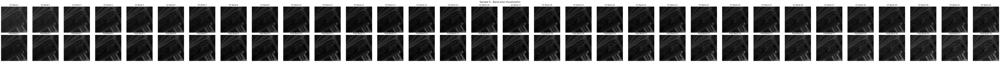

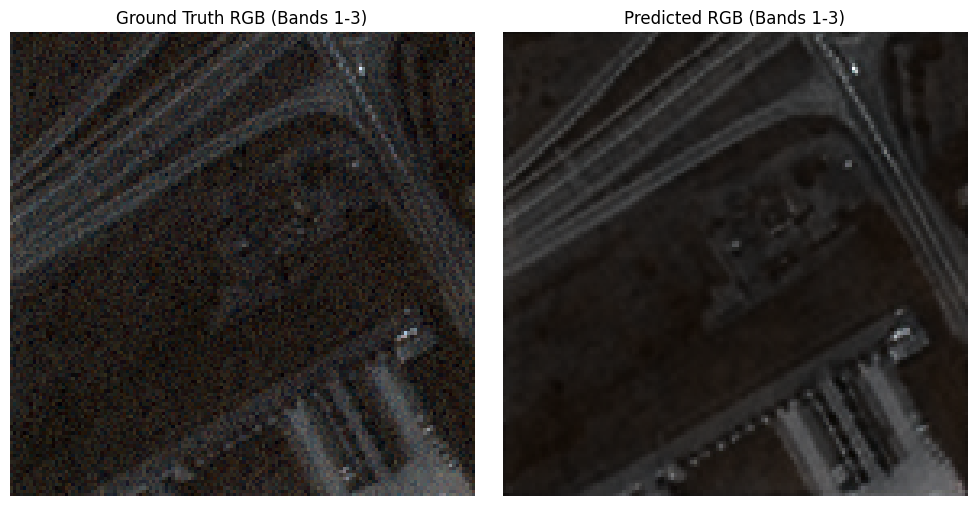

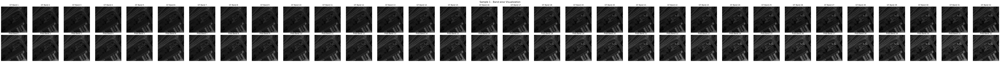

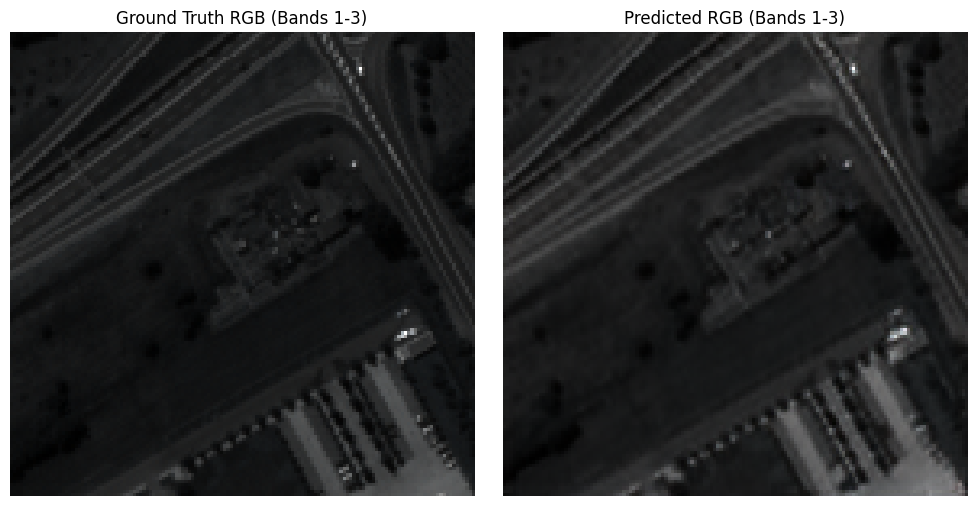

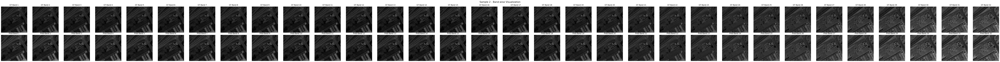

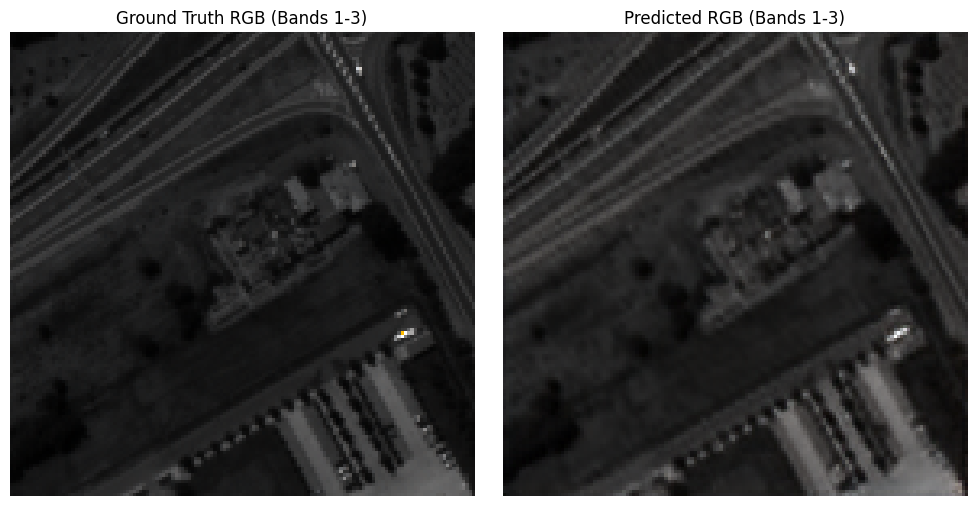

In [10]:
import matplotlib.pyplot as plt
import numpy as np

def visualize_sample(gt, pred, sample_idx=0, band_names=None):
    """
    Visualizes ground truth and predicted images for each band and RGB-like composite.

    Args:
        gt: Ground truth array of shape (N, H, W, B)
        pred: Predicted array of shape (N, H, W, B)
        sample_idx: Index of the sample to visualize
        band_names: Optional list of band names for display
    """
    gt_sample = gt[sample_idx]
    pred_sample = pred[sample_idx]
    bands = gt_sample.shape[-1]

    fig, axes = plt.subplots(2, bands, figsize=(bands * 3, 6))

    for b in range(bands):
        gt_band = gt_sample[..., b]
        pred_band = pred_sample[..., b]

        axes[0, b].imshow(gt_band, cmap='gray')
        axes[0, b].set_title(f"GT Band {b+1}" if not band_names else f"GT {band_names[b]}")
        axes[0, b].axis('off')

        axes[1, b].imshow(pred_band, cmap='gray')
        axes[1, b].set_title(f"Pred Band {b+1}" if not band_names else f"Pred {band_names[b]}")
        axes[1, b].axis('off')

    plt.suptitle(f"Sample {sample_idx} - Band-wise Visualization", fontsize=16)
    plt.tight_layout()
    plt.show()

    # RGB composite (using first 3 bands as an example)
    if bands >= 3:
        gt_rgb = gt_sample[..., :3]
        pred_rgb = pred_sample[..., :3]

        gt_rgb_norm = (gt_rgb - np.min(gt_rgb)) / (np.max(gt_rgb) - np.min(gt_rgb))
        pred_rgb_norm = (pred_rgb - np.min(pred_rgb)) / (np.max(pred_rgb) - np.min(pred_rgb))

        fig, axs = plt.subplots(1, 2, figsize=(10, 5))
        axs[0].imshow(gt_rgb_norm)
        axs[0].set_title("Ground Truth RGB (Bands 1-3)")
        axs[0].axis('off')

        axs[1].imshow(pred_rgb_norm)
        axs[1].set_title("Predicted RGB (Bands 1-3)")
        axs[1].axis('off')

        plt.tight_layout()
        plt.show()

# Example usage:
# Visualize first 3 samples from your predicted_hr_images and X_test_hr
for i in range(3):
    visualize_sample(X_test_hr, predicted_hr_images, sample_idx=i)


In [12]:
import matplotlib.pyplot as plt
import numpy as np

def visualize_sample(gt, pred, sample_idx=0, band_names=None, colormap='viridis', rgb_bands=(30, 20, 10)):
    """
    Visualizes ground truth and predicted images for each band and a custom RGB-like composite.

    Args:
        gt: Ground truth array of shape (N, H, W, B)
        pred: Predicted array of shape (N, H, W, B)
        sample_idx: Index of the sample to visualize
        band_names: Optional list of band names for display
        colormap: Colormap to use for band-wise visualization
        rgb_bands: Tuple of three band indices to use for RGB composite (default: (30, 20, 10))
    """
    gt_sample = gt[sample_idx]
    pred_sample = pred[sample_idx]
    bands = gt_sample.shape[-1]

    fig, axes = plt.subplots(2, bands, figsize=(bands * 3, 6))

    for b in range(bands):
        gt_band = gt_sample[..., b]
        pred_band = pred_sample[..., b]

        im1 = axes[0, b].imshow(gt_band, cmap=colormap)
        axes[0, b].set_title(f"GT Band {b+1}" if not band_names else f"GT {band_names[b]}")
        axes[0, b].axis('off')
        plt.colorbar(im1, ax=axes[0, b], fraction=0.046, pad=0.04)

        im2 = axes[1, b].imshow(pred_band, cmap=colormap)
        axes[1, b].set_title(f"Pred Band {b+1}" if not band_names else f"Pred {band_names[b]}")
        axes[1, b].axis('off')
        plt.colorbar(im2, ax=axes[1, b], fraction=0.046, pad=0.04)

    plt.suptitle(f"Sample {sample_idx} - Band-wise Visualization", fontsize=16)
    plt.tight_layout()
    plt.show()

    # RGB composite using specified bands
    if bands > max(rgb_bands):
        gt_rgb = np.stack([gt_sample[..., i] for i in rgb_bands], axis=-1)
        pred_rgb = np.stack([pred_sample[..., i] for i in rgb_bands], axis=-1)

        gt_rgb_norm = (gt_rgb - np.min(gt_rgb)) / (np.max(gt_rgb) - np.min(gt_rgb) + 1e-8)
        pred_rgb_norm = (pred_rgb - np.min(pred_rgb)) / (np.max(pred_rgb) - np.min(pred_rgb) + 1e-8)

        fig, axs = plt.subplots(1, 2, figsize=(10, 5))
        axs[0].imshow(gt_rgb_norm)
        axs[0].set_title(f"Ground Truth RGB (Bands {rgb_bands})")
        axs[0].axis('off')

        axs[1].imshow(pred_rgb_norm)
        axs[1].set_title(f"Predicted RGB (Bands {rgb_bands})")
        axs[1].axis('off')

        plt.tight_layout()
        plt.show()
    else:
        print(f"Cannot form RGB composite: one or more specified bands {rgb_bands} exceed available bands ({bands})")


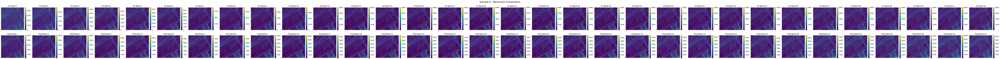

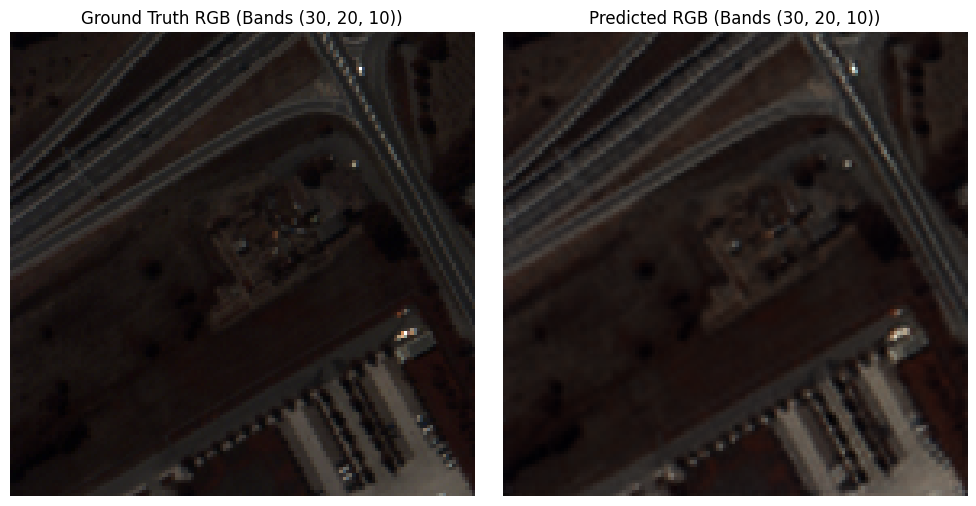

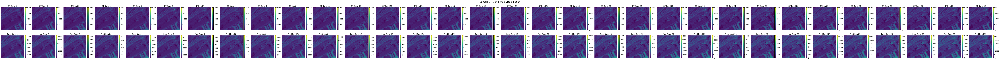

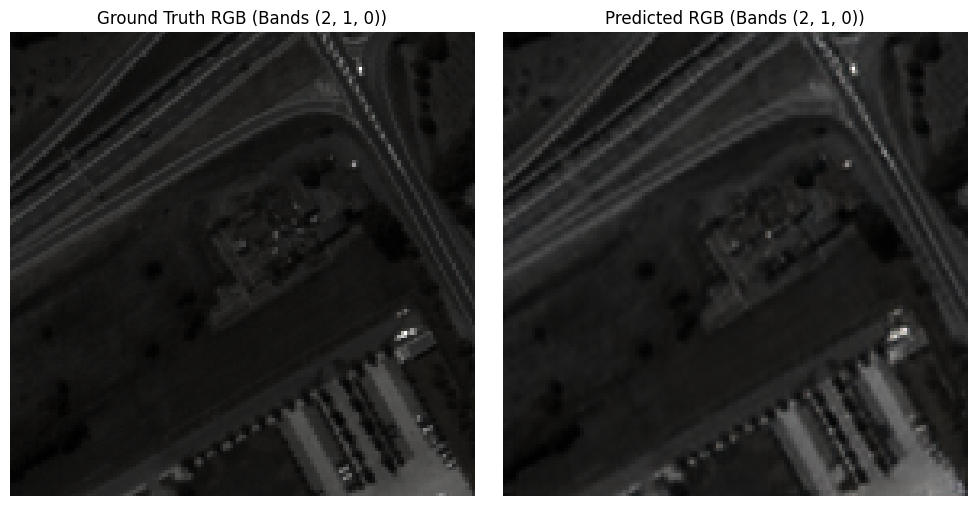

In [14]:
# For RGB from Near-IR (band 30), Red (band 20), Green (band 10)
visualize_sample(X_test_hr, predicted_hr_images, sample_idx=0, rgb_bands=(30, 20, 10))

# For typical visible RGB (assuming bands 0–2 are B, G, R)
visualize_sample(X_test_hr, predicted_hr_images, sample_idx=1, rgb_bands=(2, 1, 0))


In [18]:
import matplotlib.pyplot as plt
import numpy as np

def visualize_rgb_sample(gt, pred, sample_idx=0, rgb_bands=(30, 22, 5), figsize=(10, 5), title_prefix=""):
    """
    Visualizes ground truth and predicted RGB composite images from hyperspectral data.

    Args:
        gt: Ground truth array of shape (N, H, W, B)
        pred: Predicted array of shape (N, H, W, B)
        sample_idx: Index of the sample to visualize
        rgb_bands: Tuple of 3 band indices to use for RGB visualization
        figsize: Size of the output figure
        title_prefix: Optional prefix for titles (e.g., "Sample 1 - ")
    """
    gt_sample = gt[sample_idx]
    pred_sample = pred[sample_idx]

    if max(rgb_bands) >= gt_sample.shape[-1]:
        raise ValueError(f"RGB band indices {rgb_bands} exceed number of bands ({gt_sample.shape[-1]}).")

    # Compose RGB from selected bands
    gt_rgb = np.stack([gt_sample[..., i] for i in rgb_bands], axis=-1)
    pred_rgb = np.stack([pred_sample[..., i] for i in rgb_bands], axis=-1)

    # Normalize to 0–1
    gt_rgb_norm = (gt_rgb - np.min(gt_rgb)) / (np.max(gt_rgb) - np.min(gt_rgb) + 1e-8)
    pred_rgb_norm = (pred_rgb - np.min(pred_rgb)) / (np.max(pred_rgb) - np.min(pred_rgb) + 1e-8)

    # Plot
    fig, axs = plt.subplots(1, 2, figsize=figsize)
    axs[0].imshow(gt_rgb_norm)
    axs[0].set_title(f"{title_prefix}Ground Truth RGB", fontsize=14)
    axs[0].axis('off')

    axs[1].imshow(pred_rgb_norm)
    axs[1].set_title(f"{title_prefix}Predicted RGB", fontsize=14)
    axs[1].axis('off')

    plt.tight_layout()
    plt.show()


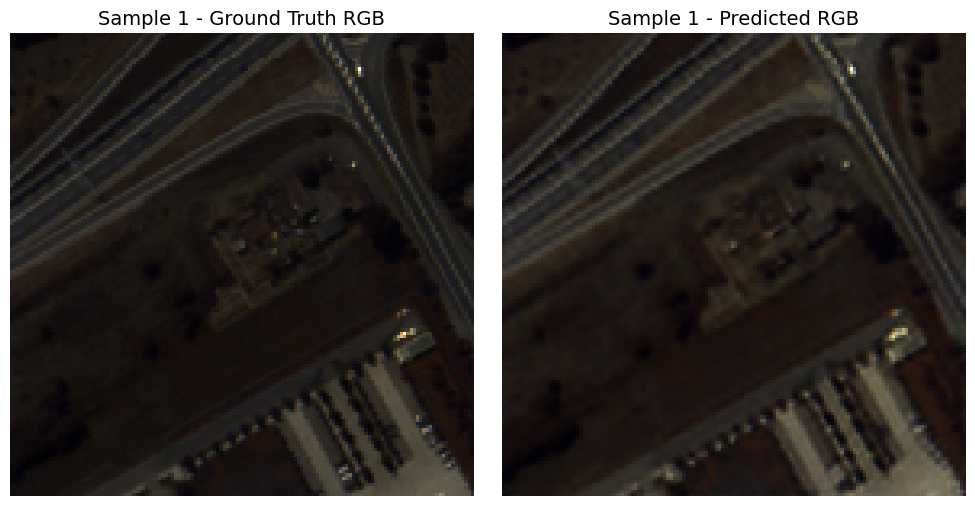

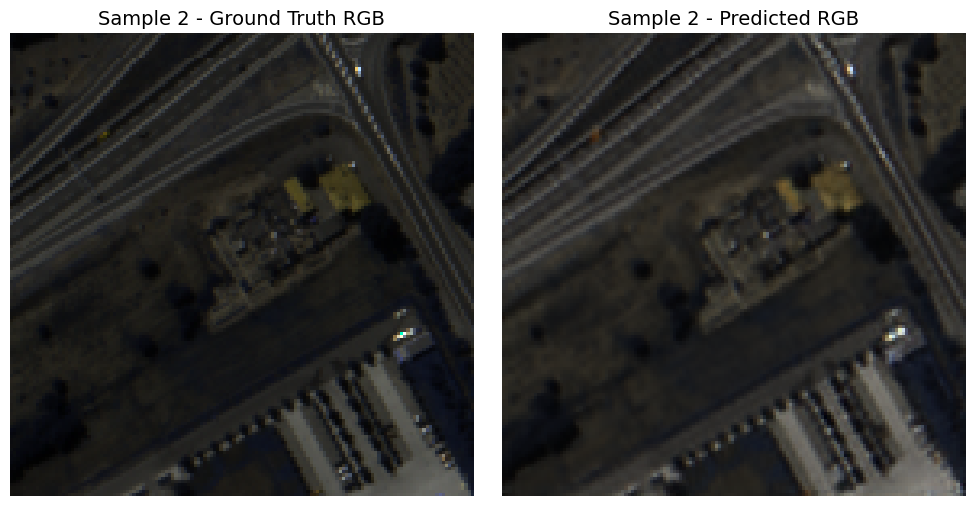

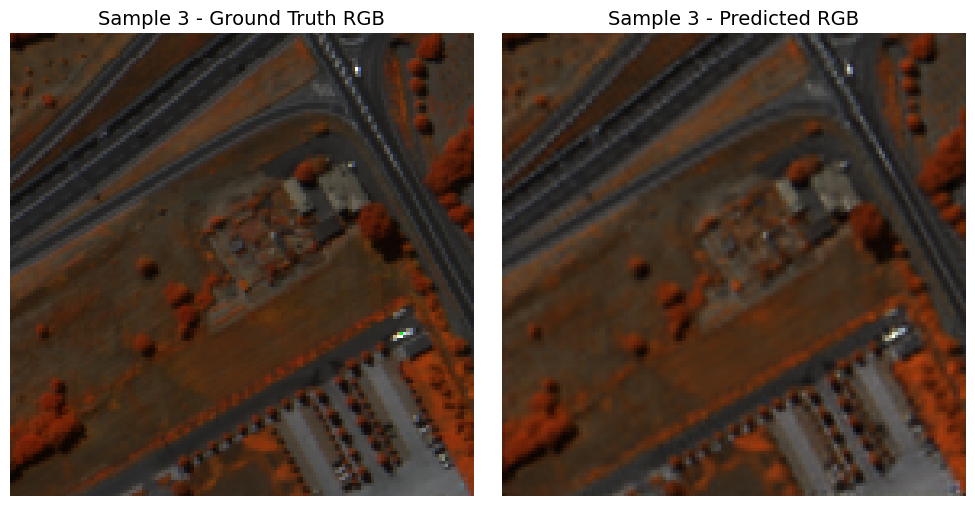

In [19]:
# Show the RGB visualization for the first 3 samples
for i in range(3):
    visualize_rgb_sample(X_test_hr, predicted_hr_images, sample_idx=i, title_prefix=f"Sample {i+1} - ")


In [8]:
def reconstruct_full_cube(grouped_patches, group_size, overlap_size, total_bands=103):
    """
    Reconstructs the full cube from grouped patches by averaging overlapping regions.
    """
    full_cube = np.zeros((grouped_patches.shape[1], grouped_patches.shape[2], total_bands))
    count = np.zeros_like(full_cube)

    step = group_size - overlap_size
    band_idx = 0
    for i in range(0, total_bands - group_size + 1, step):
        patch = grouped_patches[band_idx]
        full_cube[:, :, i:i+group_size] += patch
        count[:, :, i:i+group_size] += 1
        band_idx += 1

    # Avoid division by zero
    count[count == 0] = 1
    return full_cube / count


In [11]:
full_gt = reconstruct_full_cube(X_test_hr, group_size=32, overlap_size=8, total_bands=103)
full_pred = reconstruct_full_cube(predicted_hr_images, group_size=32, overlap_size=8, total_bands=103)


In [13]:
def visualize_rgb(gt, pred, rgb_bands=(60, 30, 15), title_prefix=""):
    """
    Show RGB composite for ground truth and predicted hyperspectral images.
    """
    gt_rgb = np.stack([gt[..., i] for i in rgb_bands], axis=-1)
    pred_rgb = np.stack([pred[..., i] for i in rgb_bands], axis=-1)

    # Normalize each RGB image
    gt_rgb = (gt_rgb - gt_rgb.min()) / (gt_rgb.max() - gt_rgb.min() + 1e-8)
    pred_rgb = (pred_rgb - pred_rgb.min()) / (pred_rgb.max() - pred_rgb.min() + 1e-8)

    import matplotlib.pyplot as plt
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    axs[0].imshow(gt_rgb)
    axs[0].set_title(f"{title_prefix} Ground Truth RGB")
    axs[0].axis('off')

    axs[1].imshow(pred_rgb)
    axs[1].set_title(f"{title_prefix} Predicted RGB")
    axs[1].axis('off')

    plt.tight_layout()
    plt.show()


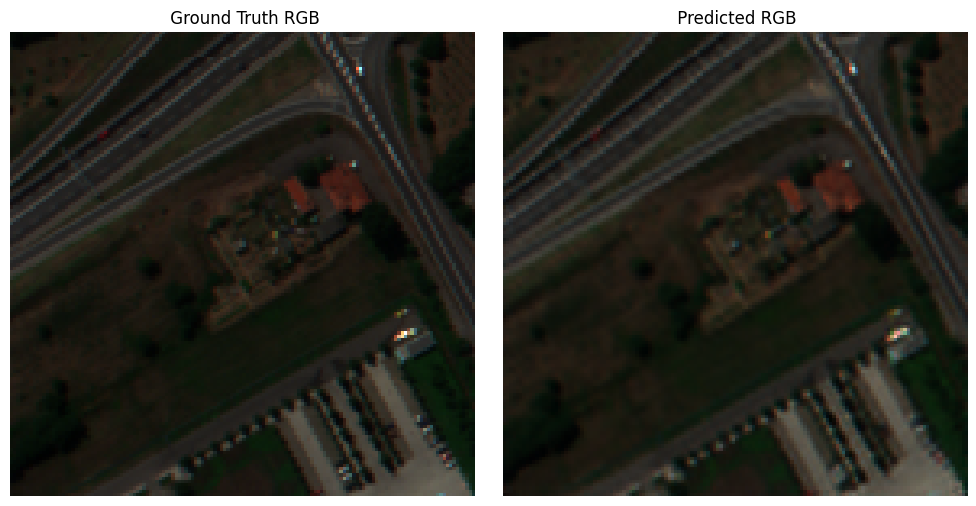

In [14]:
visualize_rgb(full_gt, full_pred)


In [12]:
visualize_rgb_sample(full_gt[np.newaxis, ...], full_pred[np.newaxis, ...], sample_idx=0, rgb_bands=(60, 30, 15))


NameError: name 'visualize_rgb_sample' is not defined

In [24]:
import numpy as np

def compute_psnr_per_sample(gt, pred, sample_names=None, max_pixel=None, verbose=True):
    """
    Computes PSNR for each (ground truth, prediction) pair and prints a report.

    Args:
        gt (np.ndarray): Ground truth array of shape (N, H, W, B)
        pred (np.ndarray): Predicted array of shape (N, H, W, B)
        sample_names (list): Optional list of names/labels for each sample.
        max_pixel (float): Optional maximum pixel value for normalization.
        verbose (bool): Whether to print the PSNR report.

    Returns:
        psnr_scores (list): List of PSNR values for each sample.
        avg_psnr (float): Mean PSNR across all samples.
    """
    if max_pixel is None:
        max_pixel = np.max(gt)

    N = gt.shape[0]
    psnr_scores = []

    for i in range(N):
        mse = np.mean((gt[i] - pred[i]) ** 2, axis=(0, 1))  # PSNR per band
        psnr_band = 20 * np.log10(max_pixel / (np.sqrt(mse) + 1e-8))
        psnr_val = np.mean(psnr_band)
        psnr_scores.append(psnr_val)

        if verbose:
            name = sample_names[i] if sample_names else f"Sample {i+1}"
            print(f"{name}: PSNR = {psnr_val:.2f} dB")

    avg_psnr = np.mean(psnr_scores)
    if verbose:
        print(f"\n📊 Average PSNR across {N} samples: {avg_psnr:.2f} dB")

    return psnr_scores, avg_psnr


In [25]:
gt_full = reconstruct_full_cube(X_test_hr, group_size=32, overlap_size=8, total_bands=103)
pred_full = reconstruct_full_cube(predicted_hr_images, group_size=32, overlap_size=8, total_bands=103)


In [26]:
compute_psnr_per_sample(gt_full[np.newaxis, ...], pred_full[np.newaxis, ...])


Sample 1: PSNR = 81.02 dB

📊 Average PSNR across 1 samples: 81.02 dB


([81.02440431710106], 81.02440431710106)

In [28]:
X_test_lr_upsampled = tf.image.resize(
    X_test_lr,
    size=(X_test_hr.shape[1], X_test_hr.shape[2]),
    method='bilinear'  # or 'bicubic'
).numpy()


In [29]:
bicubic_full = reconstruct_full_cube(X_test_lr_upsampled, group_size=32, overlap_size=8, total_bands=103)


In [30]:
compute_psnr_per_sample(gt_full[np.newaxis, ...], bicubic_full[np.newaxis, ...])


Sample 1: PSNR = 78.59 dB

📊 Average PSNR across 1 samples: 78.59 dB


([78.5919034449589], 78.5919034449589)

In [32]:
import matplotlib.pyplot as plt
import numpy as np

def visualize_band_diff(gt, pred, band_idx, cmap='inferno'):
    """
    Plots the absolute difference heatmap for a specific band.
    """
    diff = np.abs(gt[..., band_idx] - pred[..., band_idx])
    
    plt.figure(figsize=(6, 6))
    plt.imshow(diff, cmap=cmap)
    plt.title(f"Absolute Difference - Band {band_idx}", fontsize=14)
    plt.axis('off')
    plt.colorbar(label="|GT - Pred|")
    plt.show()


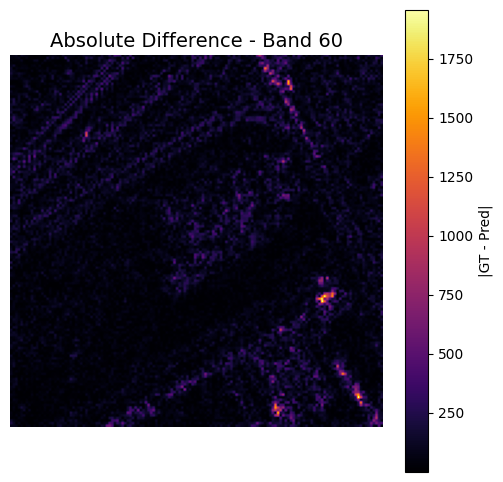

In [33]:
visualize_band_diff(full_gt, full_pred, band_idx=60)  # Red band


In [35]:
def visualize_average_diff(gt, pred, cmap='inferno'):
    """
    Plots the mean absolute error heatmap averaged across all bands.
    """
    diff = np.abs(gt - pred)
    mean_diff = np.mean(diff, axis=-1)

    plt.figure(figsize=(6, 6))
    plt.imshow(mean_diff, cmap=cmap)
   # plt.title(fontsize=14)
    plt.axis('off')
    plt.colorbar(label="Mean |GT - Pred|")
    plt.show()


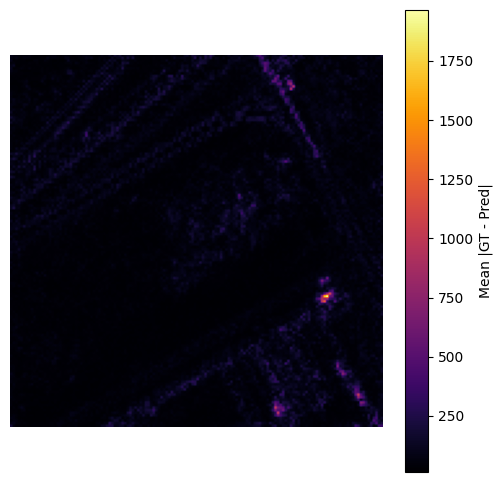

In [36]:
visualize_average_diff(full_gt, full_pred)
#Mean Absolute Error (Averaged Over All Bands

In [37]:
plt.savefig("mae_heatmap.png", dpi=400, bbox_inches='tight')


<Figure size 640x480 with 0 Axes>

In [36]:
# Assuming you already defined this earlier:
# reconstruct_full_cube(grouped_patches, group_size, overlap_size, total_bands=103)

full_gt = reconstruct_full_cube(X_test_hr, group_size=32, overlap_size=8, total_bands=103)
full_pred = reconstruct_full_cube(predicted_hr_images, group_size=32, overlap_size=8, total_bands=103)


In [37]:
import matplotlib.pyplot as plt

def plot_spectral_profile(gt, pred, x, y, bicubic=None):
    """
    Plots the spectral profile (across all bands) at pixel (x, y).

    Args:
        gt: Ground truth cube of shape (H, W, B)
        pred: Predicted cube of shape (H, W, B)
        x, y: Pixel coordinates (x = column, y = row)
        bicubic: Optional bicubic prediction cube for comparison (H, W, B)
    """
    gt_spectrum = gt[y, x, :]
    pred_spectrum = pred[y, x, :]

    plt.figure(figsize=(10, 4))
    plt.plot(gt_spectrum, label='Ground Truth', linewidth=2)
    plt.plot(pred_spectrum, label='Prediction', linestyle='--')

    if bicubic is not None:
        bicubic_spectrum = bicubic[y, x, :]
        plt.plot(bicubic_spectrum, label='Bicubic', linestyle='dotted')

    plt.xlabel("Spectral Band Index")
    plt.ylabel("Reflectance / Intensity")
    plt.title(f"Spectral Profile at (x={x}, y={y})")
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


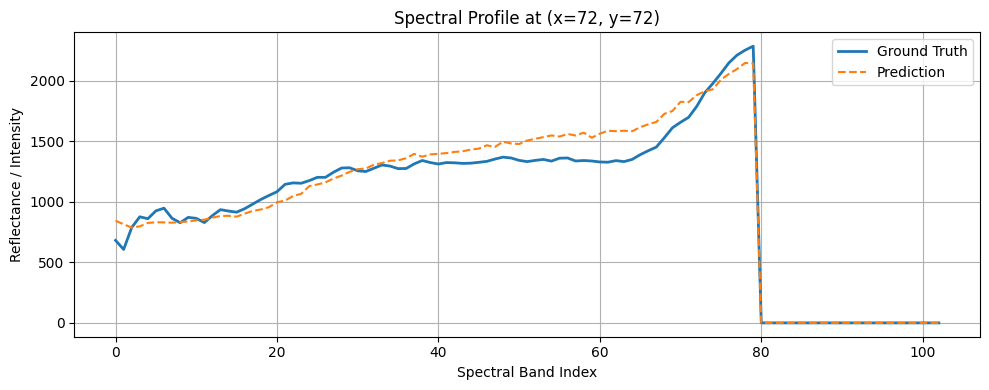

In [38]:
plot_spectral_profile(full_gt, full_pred, x=72, y=72)


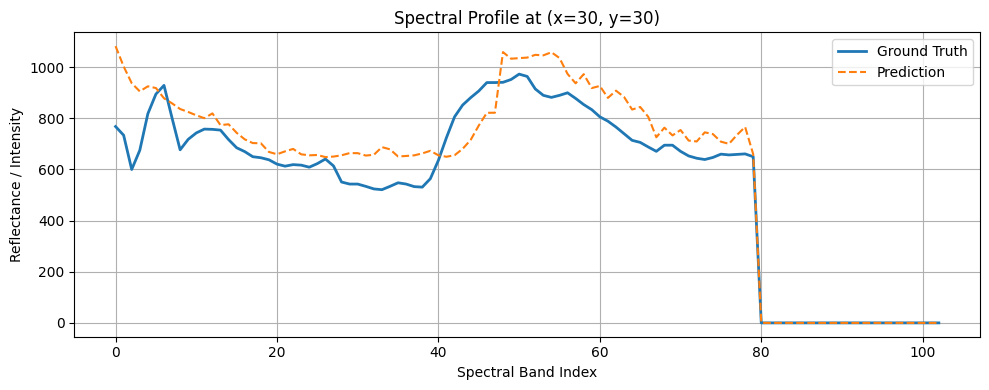

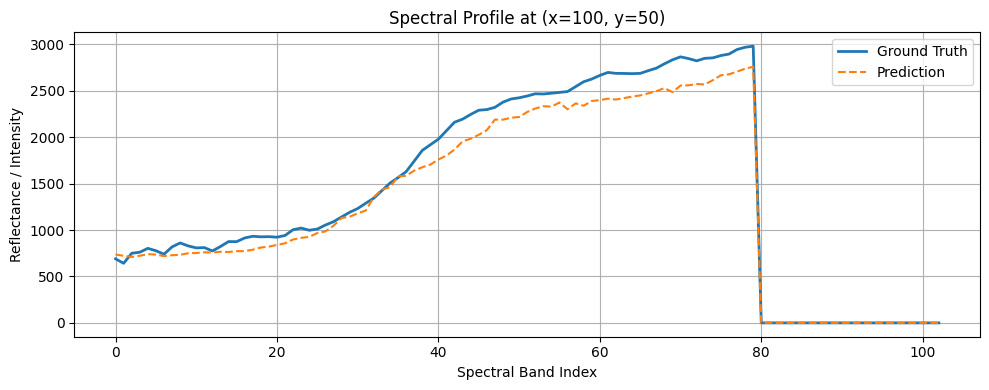

In [39]:
plot_spectral_profile(full_gt, full_pred, x=30, y=30)
plot_spectral_profile(full_gt, full_pred, x=100, y=50)


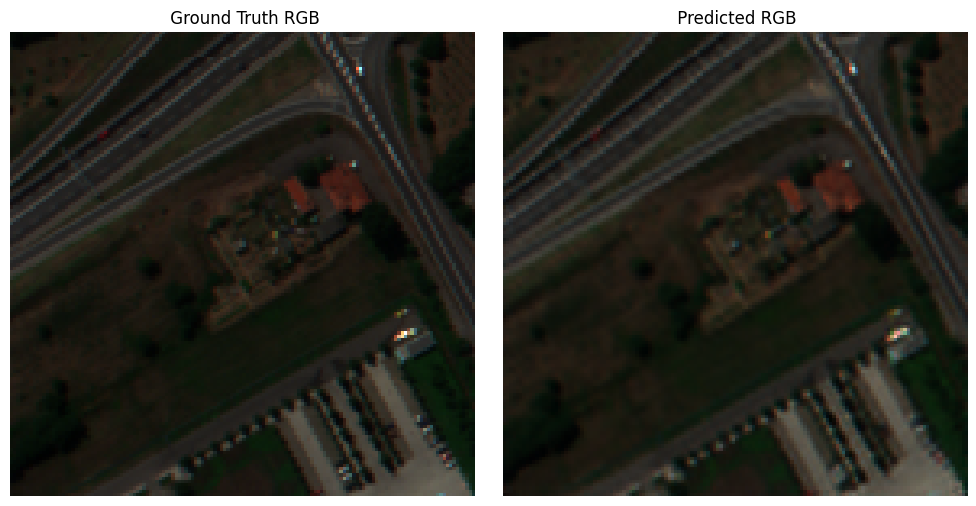

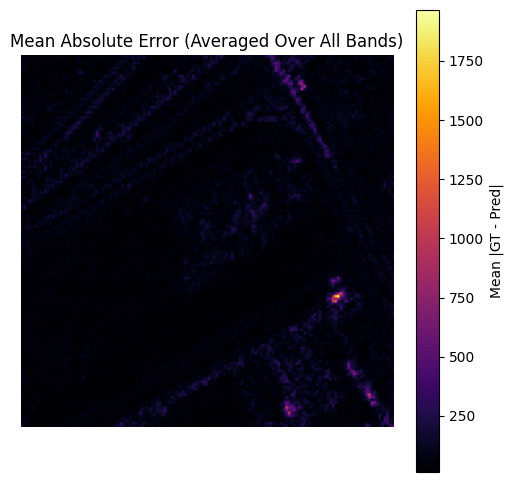

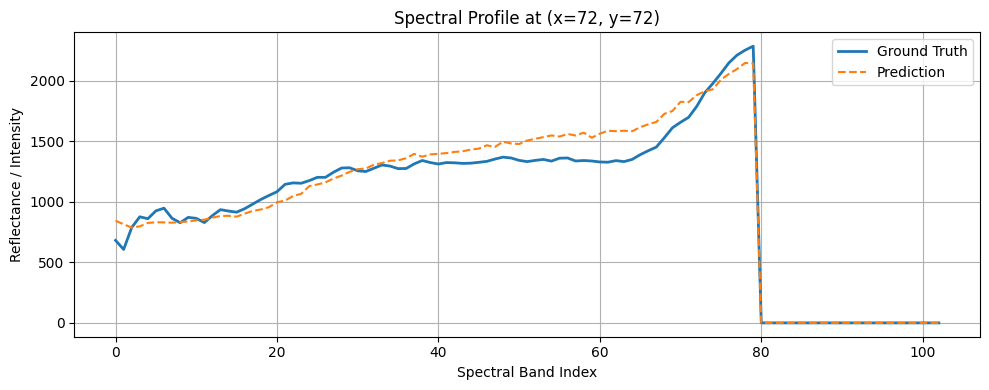

NameError: name 'visualize_selected_bands' is not defined

In [24]:
visualize_rgb(full_gt, full_pred)
visualize_average_diff(full_gt, full_pred)
plot_spectral_profile(full_gt, full_pred, x=72, y=72)
visualize_selected_bands(full_gt, full_pred, bands=[15, 30, 60])
